Mount Google Drive to have input file ready

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# CAIMAN project pipeline - Colab Version



## Required: Setup environment
Note: If you previously disconnected from the runtime without delete it, you can skip this part. Otherwise, you need to re-setup the environment.

In [ ]:
!python --version

Python 3.10.8


Run below cell only once to conda/mamba installed:

In [ ]:
!pip install -q https://github.com/conda-incubator/condacolab/archive/main.tar.gz

     - 35 kB 2.1 MB/s
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done


In [ ]:
import condacolab
condacolab.install_from_url("https://github.com/conda-forge/miniforge/\
releases/download/4.14.0-0/Mambaforge-4.14.0-0-Linux-x86_64.sh")

⏬ Downloading https://github.com/conda-forge/miniforge/releases/download/4.14.0-0/Mambaforge-4.14.0-0-Linux-x86_64.sh...
📌 Adjusting configuration...
📦 Installing...
⏲ Done in 0:01:59
🔁 Restarting kernel...


In [ ]:
!python --version

Python 3.10.6


Colab runtime will crash and restart automatically, you can proceed by running following cell to check if successful:

In [ ]:
import condacolab
condacolab.check()

Continue on installing required dependencies.
Note: there is a bug for GPU runtime $TODO

In [ ]:
!mamba install pyimagej openjdk=8 # python=3.7 # > /dev/null
!mamba install caiman opencv seaborn # > /dev/null


                  __    __    __    __
                 /  \  /  \  /  \  /  \
                /    \/    \/    \/    \
███████████████/  /██/  /██/  /██/  /████████████████████████
              /  / \   / \   / \   / \  \____
             /  /   \_/   \_/   \_/   \    o \__,
            / _/                       \_____/  `
            |/
        ███╗   ███╗ █████╗ ███╗   ███╗██████╗  █████╗
        ████╗ ████║██╔══██╗████╗ ████║██╔══██╗██╔══██╗
        ██╔████╔██║███████║██╔████╔██║██████╔╝███████║
        ██║╚██╔╝██║██╔══██║██║╚██╔╝██║██╔══██╗██╔══██║
        ██║ ╚═╝ ██║██║  ██║██║ ╚═╝ ██║██████╔╝██║  ██║
        ╚═╝     ╚═╝╚═╝  ╚═╝╚═╝     ╚═╝╚═════╝ ╚═╝  ╚═╝

        mamba (1.1.0) supported by @QuantStack

        GitHub:  https://github.com/mamba-org/mamba
        Twitter: https://twitter.com/QuantStack

█████████████████████████████████████████████████████████████


Looking for: ['pyimagej', 'openjdk=8']

conda-forge/linux-64                                        Using cache
c

Verbose cell: if you need to export dependencies to a file, run the code cell below

In [ ]:
#TODO

Retrieve local fiji ImageJ and stabilizer plugin and configure it:

In [ ]:
!wget https://downloads.imagej.net/fiji/latest/fiji-linux64.zip &> /dev/null && unzip fiji-linux64.zip > /dev/null
!rm fiji-linux64.zip
!wget https://github.com/CanYing0913/CalmAn/raw/master/Image_Stabilizer_Headless.class &> /dev/null
!mv Image_Stabilizer_Headless.class Fiji.app/plugins/Examples
import os
os.environ["JAVA_HOME"] = "/usr/local/"

Retrieve Source Code:

In [4]:
%cd /content
!wget https://raw.githubusercontent.com/CanYing0913/CalmAn/master/src_stabilizer.py &> /dev/null
!wget https://raw.githubusercontent.com/CanYing0913/CalmAn/master/src_detection.py &> /dev/null
!wget https://raw.githubusercontent.com/CanYing0913/CalmAn/master/src_caiman.py &> /dev/null
!wget https://raw.githubusercontent.com/CanYing0913/CalmAn/master/src_peak_caller.py &> /dev/null

/content


## Start of the pipeline

Required: import dependencies for the pipeline

In [ ]:
import numpy as np
import sys, cv2, tifffile, os
from time import time
from pathlib import Path

import ipywidgets as widgets
from ipywidgets import interact, fixed
import imagej, pickle

# from pipeline_source import *
from src_detection import *
from src_stabilizer import *
# from src_caiman import *

Required: Modify below to point to your input folder and output folder.
- It is recommended to set `dir_in` and `dir_out` the same.

In [ ]:
dir_in = r"/content/drive/MyDrive/caiman"
dir_out = r"/content/drive/MyDrive/caiman"

### Section 0 - Preprocessing input with cropping (based on grayscale histogram segmentation and object detection)

Required: Modify below to your input file name.

In [ ]:
fpath_in = "case1 Movie_57.tif"
fpath_in = os.path.join(dir_in, fpath_in)
image_in = tifffile.imread(fpath_in)
print(f"[INFO] Reading input image of {len(image_in)} slices, of {image_in.shape[1:]}.")

[INFO] Reading input image of 1500 slices, of (1038, 1376).


#### Segmentation

In [ ]:
st = time()
image_out, _ = denseSegmentation(image_in)
TimeSlice = len(image_out)
print(f"[INFO] Dense segmentation ends in {time()-st} seconds.")

[INFO] Dense segmentation ends in 25.338327884674072 seconds.


Visualize the segmentation quality: 

Note: Due to limited memory bandwidth, running the cell below may be **slow**.

In [ ]:
interact(examine_segmentation, image_i=fixed(image_in), image_o=fixed(image_out), idx=widgets.IntSlider(min=0, max=TimeSlice-1, step=1, value=0))

#### Object Detection: Finding the bounding box of ROI

In [ ]:
st = time()
x1, y1, x2, y2 = find_bb_3D_dense(image_out)
print(f"[INFO] bb found. Finish in {time()-st} seconds.")

[INFO] bb found. Finish in 79.92774653434753 seconds.


Apply bb to original image
- Note: You can specify the margin to do cropping, as well as name of your saved result

In [ ]:
margin = 200
image_crop = apply_bb_3D(image_in, (x1, y1, x2, y2), margin)
fpath_crop = "cropped_result.tif"
fpath_crop = os.path.join(dir_out, fpath_crop)
tifffile.imwrite(fpath_crop, image_crop)

Cleanup to save RAM

In [ ]:
del fpath_in
del x1, y1, x2, y2, st, margin
del image_in, image_out, image_crop

### Section 1 - ImageJ Stabilizer

In [ ]:
import imagej

Initailize ImageJ instance
- Note: Do **not** attempt to create more than one ImageJ instances.

In [ ]:
app_path = "/content/Fiji.app"
ij = imagej.init(app_path, mode="headless")
print(f"ImageJ version: {ij.getVersion()}")
del app_path

ERROR:jgo:Failed to bootstrap the artifact.
ERROR:jgo:
ERROR:jgo:Possible solutions:
ERROR:jgo:* Double check the endpoint for correctness (https://search.maven.org/).
ERROR:jgo:* Add needed repositories to ~/.jgorc [repositories] block (see README).
ERROR:jgo:* Try with an explicit version number (release metadata might be wrong).
ERROR:jgo:
ERROR:jgo:Full Maven error output:
ERROR:jgo:


RuntimeError: ignored

Load in output image from section 0 or from your drive
- If you already have cropped image, or you simply want to skip previous section, modify first line below!

In [ ]:
fpath_in = fpath_crop#os.path.join(dir_in,"cropped_result.tif")
imp = ij.IJ.openImage(fpath_in)
dims = imp.getDimensions()
print(f"Loading images with width * height: [{dims[0]} * {dims[1]}], total of {dims[3]} slices.")

Modify Stabilizer Parameters if you want:

In [ ]:
Transformation = "Translation"  # or "Affine"
MAX_Pyramid_level = 1
update_coefficient = 0.90
MAX_iteration = 200
error_tolerance = 1E-7

Running the stabilizer:

In [ ]:
st = time()
ij.IJ.run(imp, "Image Stabilizer Headless",
       "transformation=" + Transformation + " maximum_pyramid_levels=" + str(MAX_Pyramid_level) +
       " template_update_coefficient=" + str(update_coefficient) + " maximum_iterations=" + str(MAX_iteration) +
       " error_tolerance=" + str(error_tolerance))
print(f"Task finishes. Total of {int((time() - st) // 60)} m {int((time() - st) % 60)} s.")

Save the stabilized result. Modify the name if you want.

In [ ]:
fpath_out = "stabilized_result.tif"
fpath_out = os.path.join(dir_out, fpath_out)
ij.IJ.saveAs(imp, "Tiff", fpath_out)
imp.close()

Cleanup to save RAM

In [ ]:
del st, dims, ij
del fpath_in
del Transformation, MAX_Pyramid_level, update_coefficient, MAX_iteration, error_tolerance

### Section 2 - CaImAn

Loading BokehJS ...

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
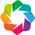

In [ ]:
import logging
logging.basicConfig(format="%(relativeCreated)12d [%(filename)s:%(funcName)20s():%(lineno)s] [%(process)d] %(message)s",
                    # filename="/tmp/caiman.log",
                    level=logging.DEBUG)
import caiman as cm
import matplotlib.pyplot as plt
from caiman.source_extraction import cnmf
from caiman.utils.utils import download_demo
from caiman.utils.visualization import inspect_correlation_pnr, nb_inspect_correlation_pnr
from caiman.motion_correction import MotionCorrect
from caiman.source_extraction.cnmf import params as params
from caiman.utils.visualization import plot_contours, nb_view_patches, nb_plot_contour
import cv2

import bokeh.plotting as bpl
import holoviews as hv
bpl.output_notebook()
hv.notebook_extension('bokeh')

Select file(s) to be processed

The `download_demo` function will download the specific file for you and return the complete path to the file which will be stored in your `caiman_data` directory. If you adapt this demo for your data make sure to pass the complete path to your file(s). Remember to pass the `fnames` variable as a list. Note that the memory requirement of the CNMF-E algorithm are much higher compared to the standard CNMF algorithm. Test the limits of your system before trying to process very large amounts of data.

In [ ]:
fnames = [os.path.join(dir_out,'cropped_result.tif')]  # filename to be processed
# fnames = [fpath_out]

Setup some parameters

We first set some parameters related to the data and motion correction and create a `params` object. We'll modify this object with additional settings later on. You can also set all the parameters at once as demonstrated in the `demo_pipeline.ipynb` notebook.

In [ ]:
# dataset dependent parameters
frate = 10                       # movie frame rate
decay_time = 0.4                 # length of a typical transient in seconds

# motion correction parameters
motion_correct = False    # flag for performing motion correction
pw_rigid = False         # flag for performing piecewise-rigid motion correction (otherwise just rigid)
gSig_filt = (3, 3)       # size of high pass spatial filtering, used in 1p data
max_shifts = (5, 5)      # maximum allowed rigid shift
strides = (48, 48)       # start a new patch for pw-rigid motion correction every x pixels
overlaps = (24, 24)      # overlap between pathes (size of patch strides+overlaps)
max_deviation_rigid = 3  # maximum deviation allowed for patch with respect to rigid shifts
border_nan = 'copy'      # replicate values along the boundaries

mc_dict = {
    'fnames': fnames,
    'fr': frate,
    'decay_time': decay_time,
    'pw_rigid': pw_rigid,
    'max_shifts': max_shifts,
    'gSig_filt': gSig_filt,
    'strides': strides,
    'overlaps': overlaps,
    'max_deviation_rigid': max_deviation_rigid,
    'border_nan': border_nan
}

opts = params.CNMFParams(params_dict=mc_dict)

Motion Correction

The background signal in micro-endoscopic data is very strong and makes the motion correction challenging.
As a first step the algorithm performs a high pass spatial filtering with a Gaussian kernel to remove the bulk of the background and enhance spatial landmarks.
The size of the kernel is given from the parameter `gSig_filt`. If this is left to the default value of `None` then no spatial filtering is performed (default option, used in 2p data).
After spatial filtering, the NoRMCorre algorithm is used to determine the motion in each frame. The inferred motion is then applied to the *original* data so no information is lost.

The motion corrected files are saved in memory mapped format. If no motion correction is being performed, then the file gets directly memory mapped.

In [ ]:
if motion_correct:
    # do motion correction rigid
    mc = MotionCorrect(fnames, dview=None, **opts.get_group('motion'))
    mc.motion_correct(save_movie=True)
    fname_mc = mc.fname_tot_els if pw_rigid else mc.fname_tot_rig
    if pw_rigid:
        bord_px = np.ceil(np.maximum(np.max(np.abs(mc.x_shifts_els)),
                                     np.max(np.abs(mc.y_shifts_els)))).astype(np.int)
    else:
        bord_px = np.ceil(np.max(np.abs(mc.shifts_rig))).astype(np.int)
        plt.subplot(1, 2, 1); plt.imshow(mc.total_template_rig)  # % plot template
        plt.subplot(1, 2, 2); plt.plot(mc.shifts_rig)  # % plot rigid shifts
        plt.legend(['x shifts', 'y shifts'])
        plt.xlabel('frames')
        plt.ylabel('pixels')

    bord_px = 0 if border_nan == 'copy' else bord_px
    fname_new = cm.save_memmap(fname_mc, base_name='memmap_', order='C',
                               border_to_0=bord_px)
else:  # if no motion correction just memory map the file
    bord_px = 0
    fname_new = cm.save_memmap(fnames, base_name='memmap_',
                               order='C', border_to_0=0, dview=None)

<>:17: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:17: SyntaxWarning: "is" with a literal. Did you mean "=="?
<ipython-input-17-088a0c340275>:17: SyntaxWarning: "is" with a literal. Did you mean "=="?
  bord_px = 0 if border_nan is 'copy' else bord_px


Load memory mapped file

In [ ]:
# load memory mappable file
print(f"memmap file located at {fname_new}")
Yr, dims, T = cm.load_memmap(fname_new)
images = Yr.T.reshape((T,) + dims, order='F')

memmap file located at /content/drive/MyDrive/memmap__d1_864_d2_845_d3_1_order_C_frames_1500_.mmap


Parameter setting for CNMF-E

We now define some parameters for the source extraction step using the CNMF-E algorithm.
We construct a new dictionary and use this to modify the *existing* `params` object,

In [ ]:
# parameters for source extraction and deconvolution
p = 1               # order of the autoregressive system
K = None            # upper bound on number of components per patch, in general None
gSig = (3, 3)       # gaussian width of a 2D gaussian kernel, which approximates a neuron
gSiz = (13, 13)     # average diameter of a neuron, in general 4*gSig+1
Ain = None          # possibility to seed with predetermined binary masks
merge_thr = .7      # merging threshold, max correlation allowed
rf = 40             # half-size of the patches in pixels. e.g., if rf=40, patches are 80x80
stride_cnmf = 20    # amount of overlap between the patches in pixels
#                     (keep it at least large as gSiz, i.e 4 times the neuron size gSig)
tsub = 2            # downsampling factor in time for initialization,
#                     increase if you have memory problems
ssub = 1            # downsampling factor in space for initialization,
#                     increase if you have memory problems
#                     you can pass them here as boolean vectors
low_rank_background = None  # None leaves background of each patch intact,
#                     True performs global low-rank approximation if gnb>0
gnb = 0             # number of background components (rank) if positive,
#                     else exact ring model with following settings
#                         gnb= 0: Return background as b and W
#                         gnb=-1: Return full rank background B
#                         gnb<-1: Don't return background
nb_patch = 0        # number of background components (rank) per patch if gnb>0,
#                     else it is set automatically
min_corr = .8       # min peak value from correlation image
min_pnr = 5        # min peak to noise ration from PNR image
ssub_B = 2          # additional downsampling factor in space for background
ring_size_factor = 1.4  # radius of ring is gSiz*ring_size_factor

opts.change_params(params_dict={'method_init': 'corr_pnr',  # use this for 1 photon
                                'K': K,
                                'gSig': gSig,
                                'gSiz': gSiz,
                                'merge_thr': merge_thr,
                                'p': p,
                                'tsub': tsub,
                                'ssub': ssub,
                                'rf': rf,
                                'stride': stride_cnmf,
                                'only_init': True,    # set it to True to run CNMF-E
                                'nb': gnb,
                                'nb_patch': nb_patch,
                                'method_deconvolution': 'oasis',       # could use 'cvxpy' alternatively
                                'low_rank_background': low_rank_background,
                                'update_background_components': True,  # sometimes setting to False improve the results
                                'min_corr': min_corr,
                                'min_pnr': min_pnr,
                                'normalize_init': False,               # just leave as is
                                'center_psf': True,                    # leave as is for 1 photon
                                'ssub_B': ssub_B,
                                'ring_size_factor': ring_size_factor,
                               }
                  )

CNMFParams:

data:

{'caiman_version': '1.9.12',
 'decay_time': 0.4,
 'dims': (864, 845),
 'dxy': (1, 1),
 'fnames': ['/content/drive/MyDrive/cropped_result.tif'],
 'fr': 10,
 'last_commit': 'FILE-1670194103',
 'mmap_C': None,
 'mmap_F': None,
 'var_name_hdf5': 'mov'}

spatial_params:

{'block_size_spat': 5000,
 'dist': 3,
 'expandCore': array([[0, 0, 1, 0, 0],
       [0, 1, 1, 1, 0],
       [1, 1, 1, 1, 1],
       [0, 1, 1, 1, 0],
       [0, 0, 1, 0, 0]]),
 'extract_cc': True,
 'maxthr': 0.1,
 'medw': None,
 'method_exp': 'dilate',
 'method_ls': 'lasso_lars',
 'n_pixels_per_process': None,
 'nb': 0,
 'normalize_yyt_one': True,
 'nrgthr': 0.9999,
 'num_blocks_per_run_spat': 20,
 'se': None,
 'ss': None,
 'thr_method': 'nrg',
 'update_background_components': True}

temporal_params:

{'ITER': 2,
 'bas_nonneg': False,
 'block_size_temp': 5000,
 'fudge_factor': 0.96,
 'lags': 5,
 'memory_efficient': False,
 'method_deconvolution': 'oasis',
 'nb': 0,
 'noise_method': 'mean',
 'noise_range':

Inspect summary images and set parameters

Check the optimal values of `min_corr` and `min_pnr` by moving slider in the figure that pops up. You can modify them in the `params` object.
Note that computing the correlation pnr image can be computationally and memory demanding for large datasets. In this case you can compute
only on a subset of the data (the results will not change). You can do that by changing `images[::1]` to `images[::5]` or something similar.
This will compute the correlation pnr image

In [ ]:
# compute some summary images (correlation and peak to noise)
cn_filter, pnr = cm.summary_images.correlation_pnr(images[::10], gSig=gSig[0], swap_dim=False) # change swap dim if output looks weird, it is a problem with tiffile
# inspect the summary images and set the parameters
nb_inspect_correlation_pnr(cn_filter, pnr)

:Layout
   .AdjointLayout.Correlation :AdjointLayout
      :Image   [x,y]   (corr)
      :DynamicMap   []
         :Histogram   [corr]   (corr_count)
   .AdjointLayout.Pnr         :AdjointLayout
      :Image   [x,y]   (pnr)
      :DynamicMap   []
         :Histogram   [pnr]   (pnr_count)

You can inspect the correlation and PNR images to select the threshold values for `min_corr` and `min_pnr`. The algorithm will look for components only in places where these value are above the specified thresholds. You can adjust the dynamic range in the plots shown above by choosing the selection tool (third button from the left) and selecting the desired region in the histogram plots on the right of each panel.

In [ ]:
# print parameters set above, modify them if necessary based on summary images
print(min_corr) # min correlation of peak (from correlation image)
print(min_pnr)  # min peak to noise ratio

0.8
5


Run the CNMF-E algorithm
- Note: this cell may take up to hours

In [ ]:
st = time()
cnm = cnmf.CNMF(n_processes=6, dview=None, Ain=Ain, params=opts)
cnm.fit(images)
ft = time()
print(f"it takes {(ft-st)//60} minutes and {(ft-st)%60} seconds to complete")

/opt/conda/lib/python3.10/site-packages/numpy/core/fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
/opt/conda/lib/python3.10/site-packages/scipy/sparse/_dia.py:338: RuntimeWarning: divide by zero encountered in remainder
  c = np.arange(num_rows, dtype=np.intc) - (offsets % max_dim)[:, None]
/opt/conda/lib/python3.10/site-packages/numpy/core/fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)
/opt/conda/lib/python3

it takes 28.0 minutes and 5.7865283489227295 seconds to complete


Component Evaluation

The processing in patches creates several spurious components. These are filtered out by evaluating each component using three different criteria:

- the shape of each component must be correlated with the data at the corresponding location within the FOV
- a minimum peak SNR is required over the length of a transient
- each shape passes a CNN based classifier

<!-- <img src="../../docs/img/evaluationcomponent.png"/> -->
After setting some parameters we again modify the existing `params` object.

In [ ]:
# the components are evaluated in three ways:
#   a) the shape of each component must be correlated with the data
#   b) a minimum peak SNR is required over the length of a transient
#   c) each shape passes a CNN based classifier

min_SNR = 3  # adaptive way to set threshold on the transient size
r_values_min = 0.85  # threshold on space consistency (if you lower more components
#                        will be accepted, potentially with worst quality)
cnm.params.set('quality', {'min_SNR': min_SNR,
                           'rval_thr': r_values_min,
                           'use_cnn': False})
cnm.estimates.evaluate_components(images, cnm.params, dview=None)

print(' ***** ')
print('Number of total components: ', len(cnm.estimates.C))
print('Number of accepted components: ', len(cnm.estimates.idx_components))

 ***** 
Number of total components:  553
Number of accepted components:  330


Do some plotting

In [ ]:
cnm.estimates.plot_contours_nb(img=cn_filter, idx=cnm.estimates.idx_components)

View traces of accepted and rejected components. Note that if you get data rate error you can start Jupyter notebooks using:
'jupyter notebook --NotebookApp.iopub_data_rate_limit=1.0e10'

In [ ]:
# accepted components
cnm.estimates.hv_view_components(img=cn_filter, idx=cnm.estimates.idx_components,
                                denoised_color='red', cmap='gray')

:DynamicMap   [unit_id,scale]
   :Layout
      .HSV.I     :HSV   [height,width]   (H,S,V)
      .Overlay.I :Overlay
         .Curve.I  :Curve   [frame #]   (y)
         .Curve.II :Curve   [frame #]   (y)
         .Text.I   :Text   [x,y]

In [ ]:
# rejected components
cnm.estimates.hv_view_components(img=cn_filter, idx=cnm.estimates.idx_components_bad,
                                denoised_color='red', cmap='gray')

:DynamicMap   [unit_id,scale]
   :Layout
      .HSV.I     :HSV   [height,width]   (H,S,V)
      .Overlay.I :Overlay
         .Curve.I  :Curve   [frame #]   (y)
         .Curve.II :Curve   [frame #]   (y)
         .Text.I   :Text   [x,y]

In [ ]:
myidx = cnm.estimates.idx_components
print(len(myidx))

(x,y) = cnm.estimates.A.shape
print(y)

330
553


Some instructive movies

Play the reconstructed movie alongside the original movie and the (amplified) residual

In [ ]:
# with background
cnm.estimates.play_movie(images, q_max=99.5, magnification=2,
                                 include_bck=True, gain_res=10, bpx=bord_px)

In [ ]:
# without background
cnm.estimates.play_movie(images, q_max=99.9, magnification=2,
                                 include_bck=False, gain_res=4, bpx=bord_px)

Get all detected spatial components

In [ ]:
import numpy as np

(x, y) = cnm.estimates.A.shape
# the index of accepted components
myidx = cnm.estimates.idx_components

coordinate1 = np.reshape(cnm.estimates.A[:, myidx[1]].toarray(), dims, order='F')
bl = coordinate1 > 0

# setup blank merge arrays. One is from merge, the other is from overlapped areas
merged = np.where(bl == True, 0, coordinate1)
mhits = np.where(bl == True, 0, coordinate1)
blm = merged > 0

for i in myidx:
    coordinate2 = np.reshape(cnm.estimates.A[:, i].toarray(), dims, order='F')
    #%% generate boolean indexing
    bl2 = coordinate2 > 0
    ct2 = np.sum(bl2)
    blm = merged > 0
    # identify the overlapped components
    bli = np.logical_and(bl2, blm)
    cti = np.sum(bli)
    # calculate the portion of the overlapped
    percent = cti / ct2
    print(percent)
    if percent < 0.25:
        # change the label of this component
        merged = np.where(bl2 == True, i + 1, merged)
        # exclude the overlapped areas
        merged = np.where(bli == True, 0, merged)
    else:
        # put the overlapped areas here
        mhits = np.where(bli == True, 999 + i, mhits)

np.savetxt(os.path.join(dir_out, r"coor_merged.csv"), merged, delimiter=",")
np.savetxt(os.path.join(dir_out, r"coor_mhits.csv"), mhits, delimiter=",")

0.0
0.3963963963963964
0.5571428571428572
0.013245033112582781
0.0
0.0
0.0
0.0
0.391304347826087
0.5161290322580645
0.0
0.3017241379310345
0.0
0.0
0.0
0.09497964721845319
0.0
0.1794871794871795
0.4482758620689655
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.07993730407523511
0.8141809290953546
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.13821138211382114
0.0
0.06993006993006994
0.8586956521739131
0.628099173553719
0.0
0.3926174496644295
0.19081272084805653
0.4230769230769231
0.0
0.0
0.19101123595505617
0.0
0.36551724137931035
0.3293172690763052
0.547486033519553
0.0
0.38557993730407525
0.0
0.0
0.6086956521739131
0.1557632398753894
0.0
0.0
0.1016949152542373
0.0
0.0
0.2804878048780488
0.4681372549019608
0.0
0.5
0.34782608695652173
0.00273224043715847
0.5919003115264797
0.0
0.0
0.1464968152866242
0.0
0.21333333333333335
0.0
0.660377358490566
0.0
0.437984496124031
0.0
0.0
0.09037900874635568
0.0
0.0
0.0
0.08949416342412451
0.0
0.6401673640167364
0.14634146341463414
0.0
0.0
0.0


Extract DF/F values

In [ ]:
(components,frames) = cnm.estimates.C.shape
print(frames)
cnm.estimates.detrend_df_f(quantileMin=8, frames_window=frames)
cnm.estimates

1500


Visualize components

In [ ]:
fpath_raw = fpath_out
image_raw = tifffile.imread(fpath_raw)
print(image_raw.shape)

In [ ]:
for i in range(92):
    roi = np.reshape(cnm.estimates.A[:, i].toarray(), dims, order='F')
    np.save(os.path.join(dir_out, r"roi_"+str(i)+".npy"), roi)
def evaluate(x):
    ROI = np.reshape(cnm.estimates.A[:, x].toarray(), dims, order='F')
    y, x =  np.unravel_index(ROI.argmax(), ROI.shape)
    plt.figure(figsize=(16, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(ROI)
    plt.title("Original ROIs")
    plt.colorbar()
    plt.subplot(1, 2, 2)
    ROI_temp = ROI*255+image_raw[x]
    ROI_temp = cv2.rectangle(ROI_temp, (x, y), (x + 15, y + 15), (255,0,0), 4)
    plt.imshow(ROI_temp)
    plt.colorbar()
    plt.title("ROIs with original image overlay")
    plt.figure()
    plt.plot(cnm.estimates.C[x])
    plt.title("Intensity vs. Time")

Note: code cell below will take a long time due to limited memory bandwidth

In [ ]:
interact(evaluate, x=widgets.IntSlider(min=0, max=91, step=1, value=0))

Reconstruct denoised movie

In [ ]:
denoised = cm.movie(cnm.estimates.A.dot(cnm.estimates.C)).reshape(dims + (-1,), order='F').transpose([2, 0, 1])

In [ ]:
denoised.save(os.path.join(dir_out, 'denoised.tif'))

In [ ]:
path = os.path.join(dir_out, "cmn_obj")
with open(path, "wb") as f:
    pickle.dump(cnm, f)
    print(f"object cnm dumped to {path}, with memory mapped file at {fname_new}")

object cnm dumped to /content/drive/MyDrive/cmn_obj, with memory mapped file at /content/drive/MyDrive/memmap__d1_864_d2_845_d3_1_order_C_frames_1500_.mmap


### Section 3 - Peak Caller

In [5]:
from src_peak_caller import *

In [ ]:
from numpy.linalg import matrix_power
import h5py
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from numpy import linalg as LA

In [ ]:
#debug cell
print(dims)

(864, 845)


In [ ]:
filename=os.path.join(dir_out, "cmn_obj") #Here I don't know how you read the original data, but you only need to remove extension and put it here
with open(filename, "rb") as f:
    cmn = pickle.load(f)

In [ ]:
print(cmn.__dir__())

['dview', 'dims', 'empty_merged', 'skip_refinement', 'remove_very_bad_comps', 'params', 'estimates', 'mmap_file', '__module__', '__doc__', '__init__', 'fit_file', 'refit', 'fit', 'save', 'remove_components', 'compute_residuals', 'deconvolve', 'HALS4traces', 'HALS4footprints', 'update_temporal', 'update_spatial', 'merge_comps', 'initialize', 'preprocess', '__dict__', '__weakref__', '__new__', '__repr__', '__hash__', '__str__', '__getattribute__', '__setattr__', '__delattr__', '__lt__', '__le__', '__eq__', '__ne__', '__gt__', '__ge__', '__reduce_ex__', '__reduce__', '__subclasshook__', '__init_subclass__', '__format__', '__sizeof__', '__dir__', '__class__']


In [ ]:
print(cmn.estimates.A.shape)
print(cmn.estimates.C.shape)

(730080, 553)
(553, 1500)


In [ ]:
data = cmn.estimates.C[:92, :]
data.shape

(92, 1500)

In [ ]:
dir=os.path.join(dir_out,'result')

In [8]:
#Here is an example code of how you should use PeakCaller
#Assume data is your numpy array
#First set the file name
data = np.reshape(cmn.estimates.A[:, i].toarray(), dims, order='F')
Caller_obj_1=PeakCaller(data,dir)
Caller_obj_1.Detrender_2()
Caller_obj_1.Find_Peak()
#The above code generates a PeakCaller object with peaks detected
Caller_obj_1.Print_ALL_Peaks()
Caller_obj_1.Raster_Plot()
Caller_obj_1.Histogram_Height()
Caller_obj_1.Histogram_Time()
Caller_obj_1.Correlation()
#To save results, do something like this:
Caller_obj_1.Synchronization()
Caller_obj_1.Save_Result()

KeyboardInterrupt: ignored